In [1]:
%load_ext autoreload
%autoreload 2

# Library imports

In [2]:
# import the libraries and models
import os
import numpy as np
from skimage import io
#import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm, tqdm_notebook
from time import sleep
from time import time
from utils.dirs import listdir_nohidden
from utils.factory import create
from utils.logger import Logger
from utils.dirs import create_dirs
from models import *
from trainers import *
import tensorflow as tf
init = tf.global_variables_initializer()
from utils.config import process_config
from utils.config import get_config_from_json
#import matplotlib
#matplotlib.use("Agg")
import matplotlib.pyplot as plt
#from matplotlib.offsetbox import OffsetImage, AnnotationBbox
#from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
from sklearn import manifold
from sklearn.metrics import roc_curve, auc, precision_recall_fscore_support, precision_recall_curve
import matplotlib.gridspec as gridspec
import seaborn as sns
import pandas as pd
from tqdm import tqdm
import numpy as np
from time import sleep
from time import time
plt.style.use('seaborn') 
inference_dir = "inference_saves"
if not os.path.exists(inference_dir):
    os.mkdir(inference_dir)
#from IPython.core.interactiveshell import InteractiveShell
#InteractiveShell.ast_node_interactivity = "all"
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina')
import os
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [3]:
def show_anomalies(patch_array):
        num_figs = len(patch_array)
        fig = plt.figure(figsize=(num_figs * 30,30))
        plt.tight_layout()
        for i in range(len(patch_array)):
            plt.subplot(num_figs,1, i+1)
            plt.imshow(patch_array[i])
            plt.axis('off')
def make_3_channel(image):
    return np.array([[[s,s,s] for s in r] for r in image],dtype="u1")
def add_color_red_2d(image):
    return np.array([[[0.7,s,s] for s in r] for r in image],dtype="u1")
def add_color_green_2d(image):
    return np.array([[[0.4,s,0.9] for s in r] for r in image],dtype="u1")
def add_color_yellow_2d(image):
    return np.array([[[s,0.3,0.3] for s in r] for r in image],dtype="u1")
def paint_image_anomalies(image_list,true_labels,pred_labels):
    imgs = []
    h_turns = 21
    w_turns = 32
    for img in image_list:
        image = make_3_channel(img)
        top = 0
        left = 0
        h, w = image.shape[:2]
        for adv_h in range(h_turns):
            for adv_w in range(w_turns):
                tag = img_tag[adv_h * 32 :(adv_h +1) * 32 , adv_w * 32 : (adv_w + 1 ) * 32]
                anomaly = np.sum(tag)
                if anomaly:
                    mask = np.array(tag==255)
                    image[adv_h * 32 :(adv_h +1) * 32 , adv_w * 32 : (adv_w + 1 ) * 32,0][mask] = 255
        imgs.append(image)
    return imgs

In [4]:
%matplotlib inline

# Sencebgan

In [5]:
config_file = "configs/visualize/sencebgan.json"
config, _ = get_config_from_json(config_file)
config.exp.name = "senceb_abl_14_False_False"
senceb_config = process_config(config)

In [6]:
from models.new.sencebgan import SENCEBGAN
from utils.DataLoader import DataLoader
from utils.logger import Logger
from utils.factory import create
from data_loader.data_generator import DataGenerator

l = Logger(senceb_config)
logger = l.get_logger(__name__)
sess = tf.Session()
init = tf.global_variables_initializer()
sess.run(init)
# Create the dataloader
data = create("data_loader." + senceb_config.data_loader.name)(senceb_config)
# Create the model instance
model = create("models.new." + senceb_config.model.name)(senceb_config)

2019-06-22 13:02:23,664 — utils.DataLoader — INFO — Train Dataset is already populated.
2019-06-22 13:02:23,665 — utils.DataLoader — INFO — Test Dataset is already populated
2019-06-22 13:02:23,665 — data_loader.data_generator — INFO — Data is loading...
2019-06-22 13:02:23,856 — utils.DataLoader — INFO — Train Dataset is Loaded
2019-06-22 13:02:34,099 — base.base_model — INFO — Building training graph...
2019-06-22 13:02:42,920 — base.base_model — INFO — Building Testing Graph...


In [7]:
model.load(sess)

2019-06-22 13:02:45,112 — base.base_model — INFO — Loading model checkpoint Ablation/senceb_abl_14_False_False/checkpoint/-644000 ...

INFO:tensorflow:Restoring parameters from Ablation/senceb_abl_14_False_False/checkpoint/-644000
2019-06-22 13:02:45,958 — base.base_model — INFO — Model loaded


100%|██████████| 672/672 [00:18<00:00, 39.90it/s]


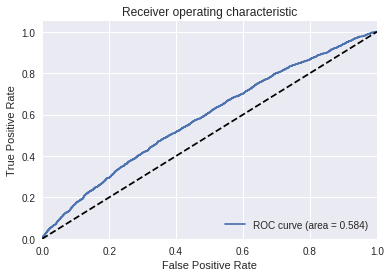

In [8]:
scores_final_2 = []
imgs = []
inference_time = []
true_labels = []
noise_dim = senceb_config.trainer.noise_dim
test_loop = tqdm(range(senceb_config.data_loader.num_iter_per_test))
sess.run(data.test_iterator.initializer)
for _ in test_loop:
    test_batch_begin = time()
    test_batch, test_labels, ground_truth = sess.run(
        [data.test_image, data.test_label, data.ground_truth]
    )
    test_loop.refresh()  # to show immediately the update
    sleep(0.01)
    noise = np.random.normal(
                loc=0.0, scale=1.0, size=[senceb_config.data_loader.test_batch, noise_dim]
    )
    feed_dict = {
        model.image_input: test_batch,
        model.noise_tensor: noise,
        model.is_training_gen: False,
        model.is_training_dis: False,
        model.is_training_enc_g: False,
        model.is_training_enc_r: False,
    }
    scores_final_2 += sess.run(model.final_score_2, feed_dict=feed_dict).tolist()
    inference_time.append(time() - test_batch_begin)
    true_labels += test_labels.tolist()
    imgs.append(np.asarray(test_batch))
true_labels = np.asarray(true_labels)
inference_time = np.mean(inference_time)
scores_final_2 = np.asarray(scores_final_2)
fpr, tpr, _ = roc_curve(true_labels, scores_final_2)
roc_auc = auc(fpr, tpr)  # compute area under the curve
plt.figure()
plt.plot(fpr, tpr, label="ROC curve (area = %0.3f)" % (roc_auc))
plt.plot([0, 1], [0, 1], "k--")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Receiver operating characteristic")
plt.legend(loc="lower right")



(672, 40, 32, 32)
(40, 32, 32)
(26880, 32, 32)


In [17]:
num = 1
def paint_anomalies(num,statistics=False,show=False):
    patch_image = np.zeros(2064384,dtype=int)
    patch_image = patch_image.reshape(672,1024,3)
    #plt.imshow(patch_image)
    tests = imgs_3[672 * num:672 * (num+1)]
    preds = scores_pred[672 * num:672 * (num+1)]
    real = tl_bool[672 * num:672 * (num+1)]
    height = 21
    width = 32
    trues = 0
    fps = 0
    fns = 0
    for i in range(height):
        for j in range(width):
            index = j + (width * i)
            if preds[index] and real[index]:
                # make it green, correct_guess
                add = add_color_green_2d(tests[index] * 255)
                trues+= 1
            elif preds[index]: #false positive
                add = add_color_red_2d(tests[index] * 255)
                fps+=1
            elif real[index]: # False Negative
                add = add_color_yellow_2d(tests[index] * 255)
                fns +=1
            else:
                add = make_3_channel(tests[index] * 255)
            patch_image[i * 32 : (i+1) * 32 , j * 32 : (j+1) * 32] += add 
    if statistics:
        print("true predictions: {}".format(trues))
        print("False Positives: {}".format(fps))
        print("False Negatives: {}".format(fns))
    if show:
        plt.figure(figsize=(15,15))
        plt.imshow(patch_image)
        return
    return patch_image


true predictions: 51
False Positives: 72
False Negatives: 28


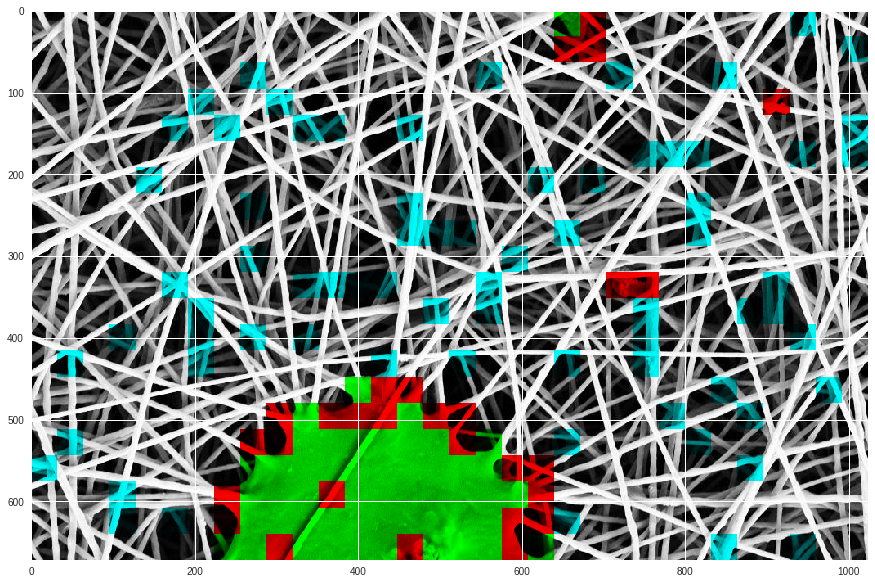

In [18]:
paint_anomalies(0,statistics=True,show=True)

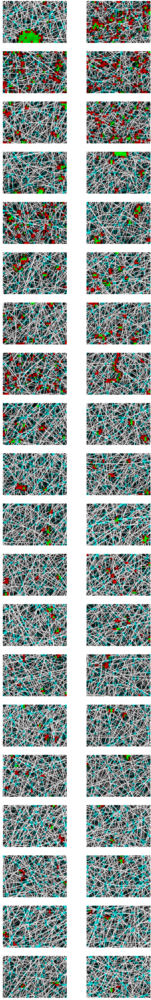

In [20]:
fig = plt.figure(figsize=(30,200))
for i in range(40):
    hoho = paint_anomalies(i)
    plt.subplot(20,2, i+1)
    plt.imshow(hoho)
    plt.axis('off')

# AnoGAN

In [ ]:
config_file = 'configs/anogan.json'
exp_name = "anogan_1"
config_anogan = process_config(config_file,exp_name)

In [ ]:
# Create the dataloader
data = create("data_loader." + config_anogan.data_loader.name)(config_anogan)
# Create the summarizer Object
summarizer = create("utils." + config_anogan.log.name)(sess, config_anogan)
# Create the model instance
model = create("models." + config_anogan.model.name)(config_anogan)
# Create the trainer
trainer = create("trainers." + config_anogan.trainer.name)(sess, model, data, config_anogan, summarizer)
# Load model if exists
model.load(sess)


# BiGAN

In [11]:
config_file = 'configs/32/bigan.json'
exp_name = "bigan_32_new_lr_ablation_000"
config_bigan,_ = get_config_from_json(config_file)
config_bigan.exp.name = exp_name
config_bigan = process_config(config_bigan)

In [ ]:
sess = tf.Session()
# Create the dataloader
data_bigan = create("data_loader." + config_bigan.data_loader.name)(config_bigan)
# Create the summarizer Object
summarizer = create("utils." + config_bigan.log.name)(sess, config_bigan)
# Create the model instance
model_bigan = create("models.32." + config_bigan.model.name)(config_bigan)
# Create the trainer
trainer_bigan = create("trainers." + config_bigan.trainer.name)(sess, model_bigan, data_bigan, config_bigan, summarizer)
# Load model if exists
model_bigan.load(sess)


2019-06-14 12:01:47,832 — utils.DataLoader — INFO — Train Dataset is already populated.
2019-06-14 12:01:47,832 — utils.DataLoader — INFO — Train Dataset is already populated.
2019-06-14 12:01:47,833 — utils.DataLoader — INFO — Test Dataset is already populated
2019-06-14 12:01:47,833 — utils.DataLoader — INFO — Test Dataset is already populated
2019-06-14 12:01:47,834 — data_loader.data_generator — INFO — Data is loading...
2019-06-14 12:01:47,834 — data_loader.data_generator — INFO — Data is loading...
2019-06-14 12:01:48,024 — utils.DataLoader — INFO — Train Dataset is Loaded
2019-06-14 12:01:48,024 — utils.DataLoader — INFO — Train Dataset is Loaded
2019-06-14 12:02:17,032 — base.base_model — INFO — Building training graph...
2019-06-14 12:02:20,032 — base.base_model — INFO — Building Testing Graph...


In [4]:

# Initialize the test Dataset Iterator
sess.run(data_bigan.test_iterator.initializer)
batch_size = config_bigan.data_loader.batch_size
noise_dim = config_bigan.trainer.noise_dim
img_dims = config_bigan.trainer.image_dims
scores = []
inference_time = []
true_labels = []
# Create the scores
test_loop = tqdm(range(config_bigan.data_loader.num_iter_per_test))
for _ in test_loop:
    test_batch_begin = time()
    test_batch, test_labels = sess.run([data.test_image, data.test_label])
    test_loop.refresh()  # to show immediately the update
    sleep(0.01)
    noise = np.random.normal(
        loc=0.0, scale=1.0, size=[config_bigan.data_loader.test_batch, noise_dim]
    )
    feed_dict = {
        model.image_input: test_batch,
        model.noise_tensor: noise,
        model.is_training: False,
    }
    scores += sess.run(model.list_scores, feed_dict=feed_dict).tolist()
    inference_time.append(time() - test_batch_begin)
    true_labels += test_labels.tolist()
# Since the higher anomaly score indicates the anomalous one, and we inverted the labels to show that
# normal images are 0 meaning that contains no anomaly and anomalous images are 1 meaning that it contains
# an anomalous region, we first scale the scores and then invert them to match the scores
scores_bigan = np.asarray(scores)
true_labels_bigan = np.asarray(true_labels)
inference_time = np.mean(inference_time)
print("Testing: Mean inference time is {:4f}".format(inference_time))
score_bigan = os.path.join(inference_dir, "score_bigan")
label_bigan = os.path.join(inference_dir, "label_bigan")
np.save(score_bigan, scores_bigan)
np.save(label_bigan, true_labels_bigan)

100%|██████████| 3337/3337 [01:08<00:00, 48.79it/s]


Testing: Mean inference time is 0.020334


Testing at with percentile value 410.782629,percentile 80.000000,  method fm: precision = 0.0575, recall = 0.2058, f1_score = 0.0899
Testing at with percentile value 423.432324,percentile 85.000000,  method fm: precision = 0.0582, recall = 0.1562, f1_score = 0.0848
Testing at with percentile value 439.541962,percentile 90.000000,  method fm: precision = 0.0607, recall = 0.1085, f1_score = 0.0778
Testing at with percentile value 464.108156,percentile 95.000000,  method fm: precision = 0.0632, recall = 0.0565, f1_score = 0.0597
Testing at with percentile value 471.783894,percentile 96.000000,  method fm: precision = 0.0624, recall = 0.0446, f1_score = 0.0520
Testing at with percentile value 480.904013,percentile 97.000000,  method fm: precision = 0.0617, recall = 0.0331, f1_score = 0.0431
Testing at with percentile value 493.001768,percentile 98.000000,  method fm: precision = 0.0652, recall = 0.0233, f1_score = 0.0343
Testing at with percentile value 511.850155,percentile 99.000000,  me

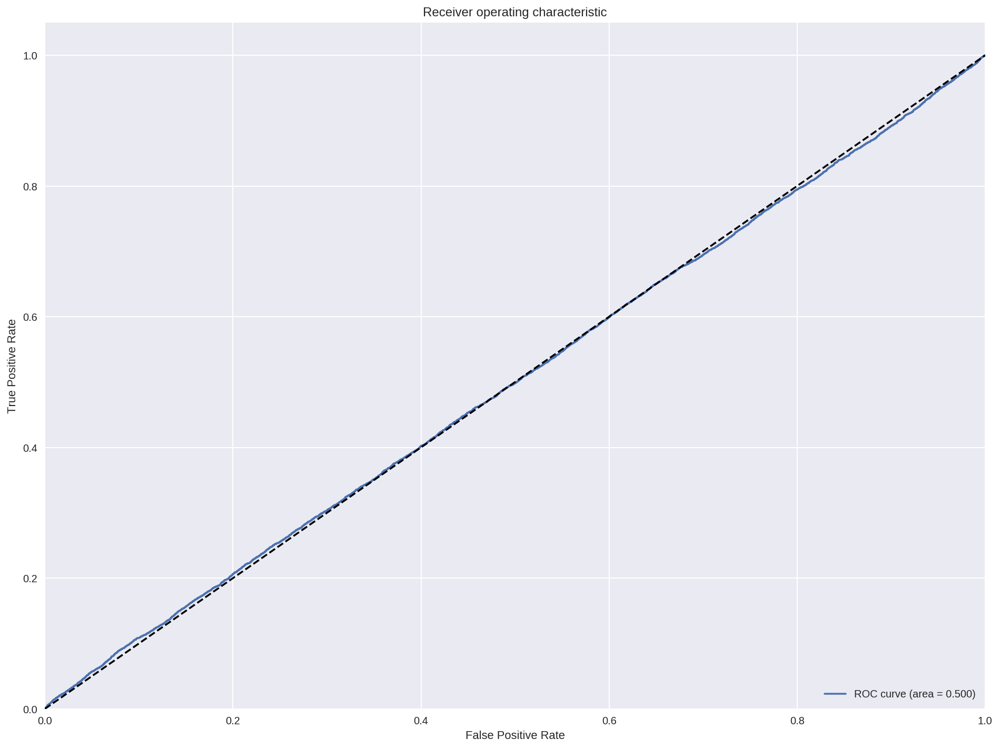

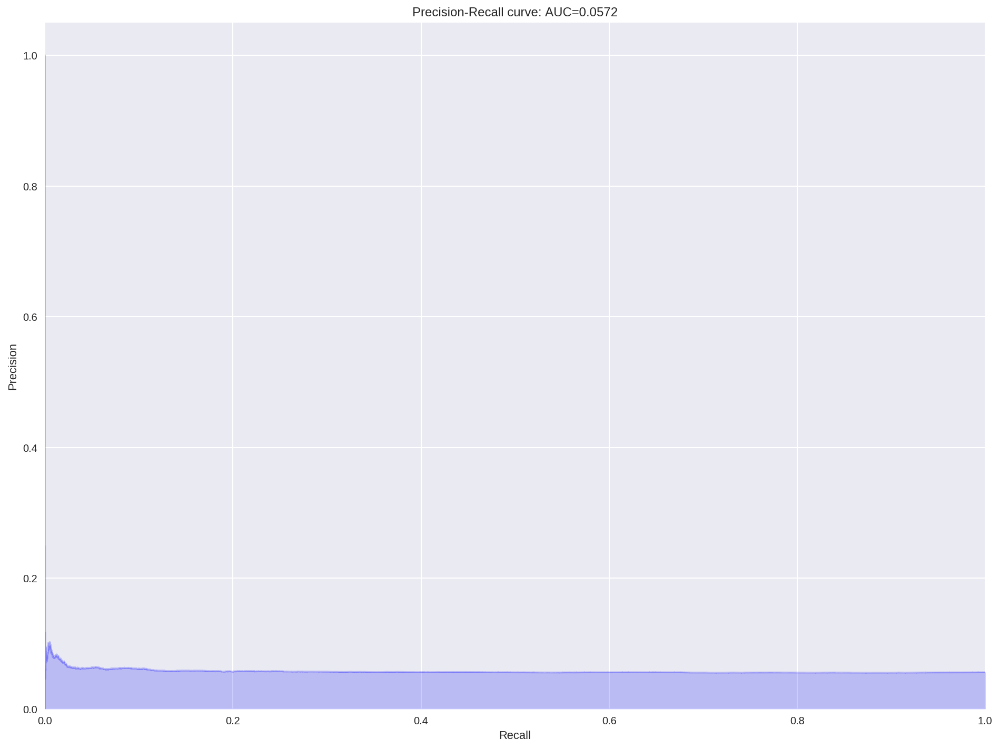

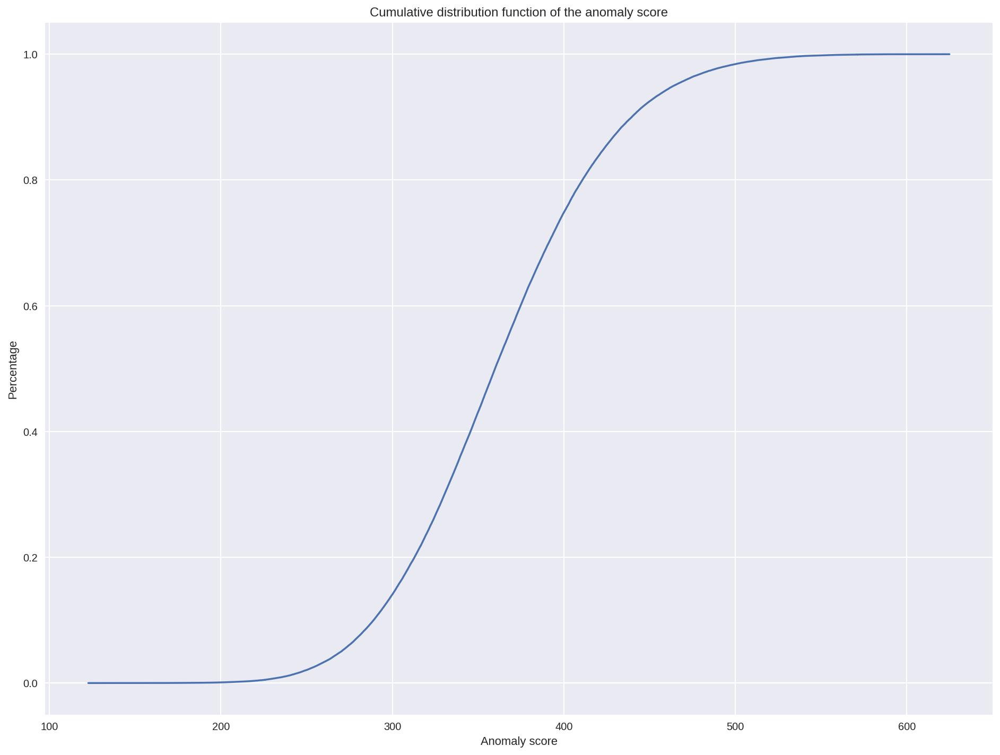

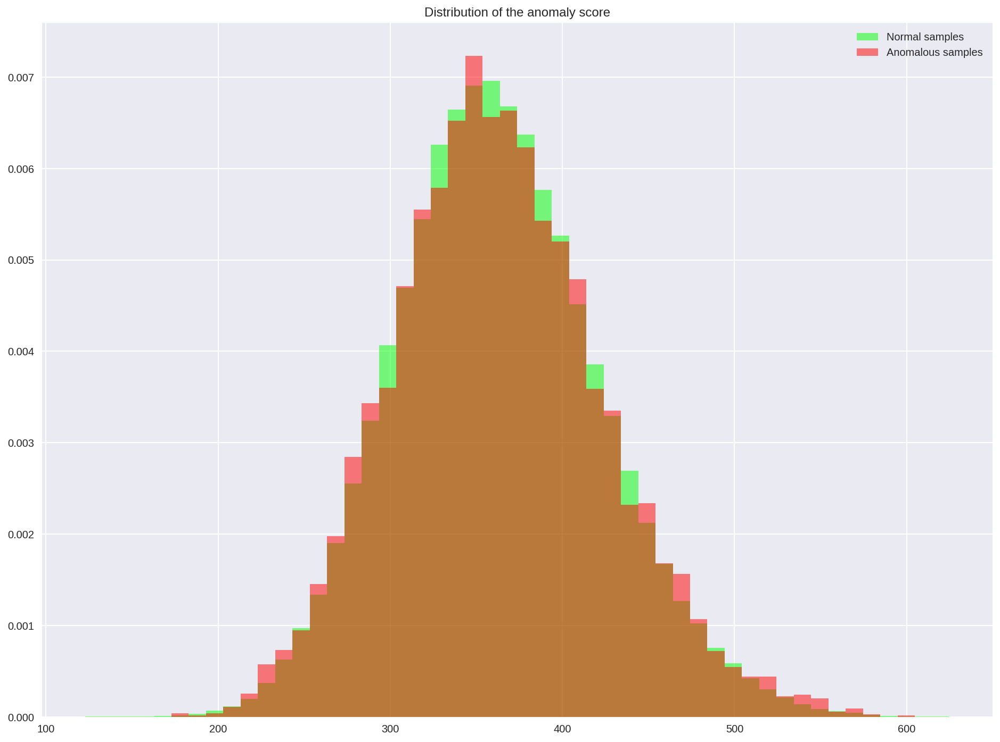

In [58]:
%matplotlib inline
score_bigan = os.path.join(inference_dir, "score_bigan.npy")
label_bigan = os.path.join(inference_dir, "label_bigan.npy")

scores_bigan = np.load(score_bigan)
true_labels_bigan = np.load(label_bigan)
percentiles = np.asarray(config_bigan.trainer.percentiles);
per = np.percentile(scores_bigan, percentiles);
for i,j in zip(per,percentiles):
    y_pred = scores_bigan >= i;
    precision, recall, f1, _ = precision_recall_fscore_support(
        true_labels_bigan.astype(int), y_pred.astype(int), average="binary"
    )
    print(
        "Testing at with percentile value %f,percentile %f,  method %s: precision = %.4f, recall = %.4f, f1_score = %.4f"
        % (i,j, "fm",precision, recall, f1 )
    )
# ROC Curve
fpr, tpr, _ = roc_curve(true_labels_bigan, scores_bigan)
roc_auc = auc(fpr, tpr)
# compute area under the curve
plt.figure(num=1,figsize=(16,12));
plt.plot(fpr, tpr, label="ROC curve (area = %0.3f)" % (roc_auc));
plt.plot([0, 1], [0, 1], "k--");
plt.xlim([0.0, 1.0]);
plt.ylim([0.0, 1.05]);
plt.xlabel("False Positive Rate");
plt.ylabel("True Positive Rate");
plt.title("Receiver operating characteristic");
plt.legend(loc="lower right");
# # PRC Curve

precision, recall, thresholds = precision_recall_curve(true_labels_bigan, scores_bigan)
prc_auc = auc(recall, precision)

plt.figure(num=2,figsize=(16,12));
plt.step(recall, precision, color="b", alpha=0.2, where="post");
plt.fill_between(recall, precision, step="post", alpha=0.2, color="b");
plt.xlabel("Recall");
plt.ylabel("Precision");
plt.ylim([0.0, 1.05]);
plt.xlim([0.0, 1.0]);
plt.title("Precision-Recall curve: AUC=%0.4f" % (prc_auc));


# # Cumulative Distribution
N = len(scores_bigan);
X2 = np.sort(scores_bigan);
F2 = np.array(range(N)) / float(N);

plt.figure(num=3,figsize=(16,12));
plt.xlabel("Anomaly score");
plt.ylabel("Percentage");
plt.title("Cumulative distribution function of the anomaly score");
plt.plot(X2, F2);


# # Histogram
plt.figure(num=4,figsize=(16,12));
idx_inliers = true_labels_bigan == 0
idx_outliers = true_labels_bigan == 1
hrange = (min(scores_bigan), max(scores_bigan))
plt.hist(
    scores_bigan[idx_inliers],
    50,
    facecolor=(0, 1, 0, 0.5),
    label="Normal samples",
    density=True,
    range=hrange,
);
plt.hist(
    scores_bigan[idx_outliers],
    50,
    facecolor=(1, 0, 0, 0.5),
    label="Anomalous samples",
    density=True,
    range=hrange,
);
plt.title("Distribution of the anomaly score");
plt.legend();

# ALAD

In [5]:
config_file = 'configs/32/alad.json'
exp_name = "alad_32_000"
config_alad,_ = get_config_from_json(config_file)
config_alad.exp.name = exp_name
process_config(config_alad)

DotMap(exp=DotMap(section='trainer', params=['flip_labels', 'soft_labels', 'include_noise'], vals=[False, True], name='alad_32_000'), model=DotMap(name='alad.ALAD'), dirs=DotMap(data='data', data_normal='data/Normal/', data_anomalous='data/Anomalous/'), data_loader=DotMap(name='data_generator.DataGenerator', random_seed=42, buffer_size=51200, image_size=32, batch_size=64, num_epochs=50, num_iter_per_epoch=800, num_parallel_calls=8, num_iter_per_test=2583, mode='anomaly', dataset_name='material', binary_location='offload', test_batch=40, validation=False, validation_percent=10), trainer=DotMap(name='alad_trainer.ALAD_Trainer', noise_dim=100, image_dims=[32, 32, 1], include_noise=False, soft_labels=False, flip_labels=False, noise_probability=0.05, discriminator_l_rate=2e-05, generator_l_rate=0.0002, optimizer_adam_beta1=0.5, optimizer_adam_beta2=0.999, batch_momentum=0.8, leakyReLU_alpha=0.2, dropout_rate=0.25, ema_decay=0.999, spectral_norm=False, allow_zz=True, enable_early_stop=False,

In [7]:
sess=tf.Session()
# Create the dataloader
data = create("data_loader." + config_alad.data_loader.name)(config_alad)
# Create the summarizer Object
summarizer = create("utils." + config_alad.log.name)(sess, config_alad)
# Create the model instance
model = create("models.{}.".format(config_alad.data_loader.image_size) + config_alad.model.name)(config_alad)
# Create the trainer
trainer = create("trainers." + config_alad.trainer.name)(sess, model, data, config_alad, summarizer)
# Load model if exists
model.load(sess)

2019-05-18 20:36:35,574 — utils.DataLoader — INFO — Train Dataset is already populated.
2019-05-18 20:36:35,574 — utils.DataLoader — INFO — Train Dataset is already populated.
2019-05-18 20:36:35,575 — utils.DataLoader — INFO — Test Dataset is already populated
2019-05-18 20:36:35,575 — utils.DataLoader — INFO — Test Dataset is already populated
2019-05-18 20:36:35,577 — data_loader.data_generator — INFO — Data is loading...
2019-05-18 20:36:35,577 — data_loader.data_generator — INFO — Data is loading...
2019-05-18 20:36:35,826 — utils.DataLoader — INFO — Train Dataset is Loaded
2019-05-18 20:36:35,826 — utils.DataLoader — INFO — Train Dataset is Loaded


ResourceExhaustedError: OOM when allocating tensor with shape[1024] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator GPU_0_bfc
	 [[node ALAD/Discriminator_Model_XZ/Discriminator_xz/y_layer_1/conv2d/bias/Adam/Assign (defined at /home/yigito19/Polimi_Thesis/models/32/alad.py:217)  = Assign[T=DT_FLOAT, _class=["loc:@ALAD/...age/Assign"], _grappler_relax_allocator_constraints=true, use_locking=true, validate_shape=true, _device="/job:localhost/replica:0/task:0/device:GPU:0"](ALAD/Discriminator_Model_XZ/Discriminator_xz/y_layer_1/conv2d/bias/Adam, ALAD/Discriminator_Model_XZ/Discriminator_xz/y_layer_1/conv2d/bias/Adam/Initializer/zeros)]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info.


Caused by op 'ALAD/Discriminator_Model_XZ/Discriminator_xz/y_layer_1/conv2d/bias/Adam/Assign', defined at:
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "/home/yigito19/.local/lib/python3.6/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/home/yigito19/.local/lib/python3.6/site-packages/traitlets/config/application.py", line 658, in launch_instance
    app.start()
  File "/home/yigito19/.local/lib/python3.6/site-packages/ipykernel/kernelapp.py", line 505, in start
    self.io_loop.start()
  File "/home/yigito19/.local/lib/python3.6/site-packages/tornado/platform/asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/asyncio/base_events.py", line 438, in run_forever
    self._run_once()
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/asyncio/base_events.py", line 1451, in _run_once
    handle._run()
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/asyncio/events.py", line 145, in _run
    self._callback(*self._args)
  File "/home/yigito19/.local/lib/python3.6/site-packages/tornado/ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "/home/yigito19/.local/lib/python3.6/site-packages/tornado/ioloop.py", line 743, in _run_callback
    ret = callback()
  File "/home/yigito19/.local/lib/python3.6/site-packages/tornado/gen.py", line 781, in inner
    self.run()
  File "/home/yigito19/.local/lib/python3.6/site-packages/tornado/gen.py", line 742, in run
    yielded = self.gen.send(value)
  File "/home/yigito19/.local/lib/python3.6/site-packages/ipykernel/kernelbase.py", line 357, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "/home/yigito19/.local/lib/python3.6/site-packages/tornado/gen.py", line 209, in wrapper
    yielded = next(result)
  File "/home/yigito19/.local/lib/python3.6/site-packages/ipykernel/kernelbase.py", line 267, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "/home/yigito19/.local/lib/python3.6/site-packages/tornado/gen.py", line 209, in wrapper
    yielded = next(result)
  File "/home/yigito19/.local/lib/python3.6/site-packages/ipykernel/kernelbase.py", line 534, in execute_request
    user_expressions, allow_stdin,
  File "/home/yigito19/.local/lib/python3.6/site-packages/tornado/gen.py", line 209, in wrapper
    yielded = next(result)
  File "/home/yigito19/.local/lib/python3.6/site-packages/ipykernel/ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "/home/yigito19/.local/lib/python3.6/site-packages/ipykernel/zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 2848, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 2874, in _run_cell
    return runner(coro)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/IPython/core/async_helpers.py", line 67, in _pseudo_sync_runner
    coro.send(None)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 3049, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 3214, in run_ast_nodes
    if (yield from self.run_code(code, result)):
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 3296, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-7-04ce9b123c18>", line 7, in <module>
    model = create("models.{}.".format(config_alad.data_loader.image_size) + config_alad.model.name)(config_alad)
  File "/home/yigito19/Polimi_Thesis/models/32/alad.py", line 14, in __init__
    self.build_model()
  File "/home/yigito19/Polimi_Thesis/models/32/alad.py", line 217, in build_model
    self.dis_loss_xz, var_list=self.dxzvars
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/training/optimizer.py", line 410, in minimize
    name=name)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/training/optimizer.py", line 593, in apply_gradients
    self._create_slots(var_list)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/training/adam.py", line 135, in _create_slots
    self._zeros_slot(v, "m", self._name)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/training/optimizer.py", line 1139, in _zeros_slot
    new_slot_variable = slot_creator.create_zeros_slot(var, op_name)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/training/slot_creator.py", line 183, in create_zeros_slot
    colocate_with_primary=colocate_with_primary)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/training/slot_creator.py", line 157, in create_slot_with_initializer
    dtype)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/training/slot_creator.py", line 65, in _create_slot_var
    validate_shape=validate_shape)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variable_scope.py", line 1487, in get_variable
    aggregation=aggregation)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variable_scope.py", line 1237, in get_variable
    aggregation=aggregation)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variable_scope.py", line 540, in get_variable
    aggregation=aggregation)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variable_scope.py", line 492, in _true_getter
    aggregation=aggregation)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variable_scope.py", line 922, in _get_single_variable
    aggregation=aggregation)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variables.py", line 183, in __call__
    return cls._variable_v1_call(*args, **kwargs)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variables.py", line 146, in _variable_v1_call
    aggregation=aggregation)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variables.py", line 125, in <lambda>
    previous_getter = lambda **kwargs: default_variable_creator(None, **kwargs)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variable_scope.py", line 2444, in default_variable_creator
    expected_shape=expected_shape, import_scope=import_scope)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variables.py", line 187, in __call__
    return super(VariableMetaclass, cls).__call__(*args, **kwargs)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variables.py", line 1329, in __init__
    constraint=constraint)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/variables.py", line 1481, in _init_from_args
    validate_shape=validate_shape).op
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/state_ops.py", line 221, in assign
    validate_shape=validate_shape)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/ops/gen_state_ops.py", line 61, in assign
    use_locking=use_locking, name=name)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/framework/op_def_library.py", line 787, in _apply_op_helper
    op_def=op_def)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/util/deprecation.py", line 488, in new_func
    return func(*args, **kwargs)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/framework/ops.py", line 3274, in create_op
    op_def=op_def)
  File "/home/yigito19/miniconda3/envs/thesis/lib/python3.6/site-packages/tensorflow/python/framework/ops.py", line 1770, in __init__
    self._traceback = tf_stack.extract_stack()

ResourceExhaustedError (see above for traceback): OOM when allocating tensor with shape[1024] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator GPU_0_bfc
	 [[node ALAD/Discriminator_Model_XZ/Discriminator_xz/y_layer_1/conv2d/bias/Adam/Assign (defined at /home/yigito19/Polimi_Thesis/models/32/alad.py:217)  = Assign[T=DT_FLOAT, _class=["loc:@ALAD/...age/Assign"], _grappler_relax_allocator_constraints=true, use_locking=true, validate_shape=true, _device="/job:localhost/replica:0/task:0/device:GPU:0"](ALAD/Discriminator_Model_XZ/Discriminator_xz/y_layer_1/conv2d/bias/Adam, ALAD/Discriminator_Model_XZ/Discriminator_xz/y_layer_1/conv2d/bias/Adam/Initializer/zeros)]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info.



In [6]:
# Initialize the test Dataset Iterator
sess.run(data.test_iterator.initializer)
batch_size = config_alad.data_loader.batch_size
noise_dim = config_alad.trainer.noise_dim
img_dims = config_alad.trainer.image_dims
scores_ch = []
scores_l1 = []
scores_l2 = []
scores_fm = []
inference_time = []
true_labels = []
# Create the scores
test_loop = tqdm(range(config_alad.data_loader.num_iter_per_test))
for _ in test_loop:
    test_batch_begin = time()
    test_batch, test_labels = sess.run([data.test_image, data.test_label])
    test_loop.refresh()  # to show immediately the update
    sleep(0.01)
    noise = np.random.normal(
        loc=0.0, scale=1.0, size=[config_alad.data_loader.test_batch, noise_dim]
    )
    feed_dict = {
        model.image_tensor: test_batch,
        model.noise_tensor: noise,
        model.is_training: False,
    }
    scores_ch += sess.run(model.score_ch, feed_dict=feed_dict).tolist()
    scores_l1 += sess.run(model.score_l1, feed_dict=feed_dict).tolist()
    scores_l2 += sess.run(model.score_l2, feed_dict=feed_dict).tolist()
    scores_fm += sess.run(model.score_fm, feed_dict=feed_dict).tolist()
    inference_time.append(time() - test_batch_begin)
    true_labels += test_labels.tolist()
scores_ch_alad = np.asarray(scores_ch)
scores_l1_alad = np.asarray(scores_l1)
scores_l2_alad = np.asarray(scores_l2)
scores_fm_alad = np.asarray(scores_fm)
true_labels_alad = np.asarray(true_labels)
inference_time = np.mean(inference_time)

score_ch_alad = os.path.join(inference_dir, "score_ch_alad")
score_l1_alad = os.path.join(inference_dir, "score_l1_alad")
score_l2_alad = os.path.join(inference_dir, "score_l2_alad")
score_fm_alad = os.path.join(inference_dir, "score_fm_alad")
label_alad = os.path.join(inference_dir, "label_alad")
np.save(score_ch_alad, scores_ch_alad)
np.save(score_l1_alad, scores_l1_alad)
np.save(score_l2_alad, scores_l2_alad)
np.save(score_fm_alad, scores_fm_alad)
np.save(label_alad, true_labels_alad)

100%|██████████| 3337/3337 [01:58<00:00, 28.21it/s]


SCORE_CH
percentile value 4.411745, percentile 80.000000, method score_ch: precision = 0.0905, recall = 0.3389, f1_score = 0.1429
percentile value 4.523324, percentile 85.000000, method score_ch: precision = 0.1002, recall = 0.2814, f1_score = 0.1478
percentile value 4.683893, percentile 90.000000, method score_ch: precision = 0.1158, recall = 0.2168, f1_score = 0.1509
percentile value 4.970635, percentile 95.000000, method score_ch: precision = 0.1397, recall = 0.1307, f1_score = 0.1351
percentile value 5.072884, percentile 96.000000, method score_ch: precision = 0.1446, recall = 0.1083, f1_score = 0.1239
percentile value 5.201793, percentile 97.000000, method score_ch: precision = 0.1504, recall = 0.0845, f1_score = 0.1082
percentile value 5.385159, percentile 98.000000, method score_ch: precision = 0.1569, recall = 0.0588, f1_score = 0.0855
percentile value 5.723048, percentile 99.000000, method score_ch: precision = 0.1547, recall = 0.0290, f1_score = 0.0488
percentile value 5.7794

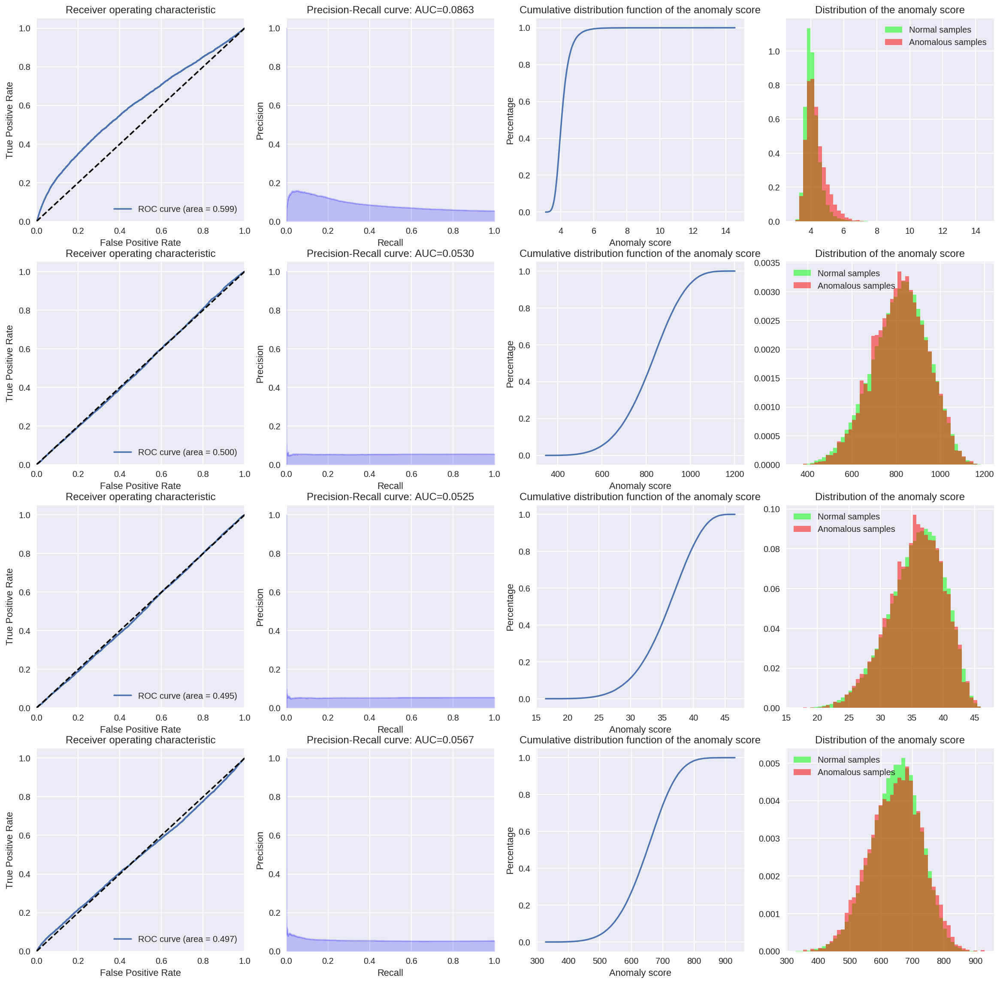

In [70]:
%matplotlib inline
percentiles = np.asarray(config_alad.trainer.percentiles);
score_ch_alad = os.path.join(inference_dir, "score_ch_alad.npy")
score_l1_alad = os.path.join(inference_dir, "score_l1_alad.npy")
score_l2_alad = os.path.join(inference_dir, "score_l2_alad.npy")
score_fm_alad = os.path.join(inference_dir, "score_fm_alad.npy")
label_alad = os.path.join(inference_dir, "label_alad.npy")
scores_ch_alad = np.load(score_ch_alad)
scores_l1_alad = np.load(score_l1_alad)
scores_l2_alad = np.load(score_l2_alad)
scores_fm_alad = np.load(score_fm_alad)
true_labels_alad = np.load(label_alad)

scores = [scores_ch_alad, scores_l1_alad, scores_l2_alad, scores_fm_alad]
print_scores = ["score_ch", "score_l1", "score_l2", "scores_fm"]
for scores_alad,kind,i in zip(scores,print_scores,range(1,5)):
    print(kind.upper())
    per = np.percentile(scores_alad, percentiles);
    for i,j in zip(per,percentiles):
        y_pred = scores_alad >= i;
        precision, recall, f1, _ = precision_recall_fscore_support(
            true_labels_alad.astype(int), y_pred.astype(int), average="binary"
        )
        print(
            "percentile value %f, percentile %f, method %s: precision = %.4f, recall = %.4f, f1_score = %.4f"
            % (i,j, kind,precision, recall, f1 )
        )

plt.figure(num=1,figsize=(20,20))
for scores_alad,kind,i in zip(scores,print_scores,range(1,5)):
    # ROC Curve
    fpr, tpr, _ = roc_curve(true_labels_alad, scores_alad)
    roc_auc = auc(fpr, tpr)
    # compute area under the curve

    #plt.figure(1 * i);
    plt.subplot(4,4,(1 + ((i-1) * 4)));
    plt.plot(fpr, tpr, label="ROC curve (area = %0.3f)" % (roc_auc));
    plt.plot([0, 1], [0, 1], "k--");
    plt.xlim([0.0, 1.0]);
    plt.ylim([0.0, 1.05]);
    plt.xlabel("False Positive Rate");
    plt.ylabel("True Positive Rate");
    plt.title("Receiver operating characteristic");
    plt.legend(loc="lower right");


    # # PRC Curve

    precision, recall, thresholds = precision_recall_curve(true_labels_alad, scores_alad)
    prc_auc = auc(recall, precision)

#     plt.figure(2 * i);
    plt.subplot(4,4,(2 + ((i-1) * 4)));
    plt.step(recall, precision, color="b", alpha=0.2, where="post");
    plt.fill_between(recall, precision, step="post", alpha=0.2, color="b");
    plt.xlabel("Recall");
    plt.ylabel("Precision");
    plt.ylim([0.0, 1.05]);
    plt.xlim([0.0, 1.0]);
    plt.title("Precision-Recall curve: AUC=%0.4f" % (prc_auc));


    # # Cumulative Distribution
    N = len(scores_alad);
    X2 = np.sort(scores_alad);
    F2 = np.array(range(N)) / float(N);

    #plt.figure(3 * i);
    plt.subplot(4,4,(3 + ((i-1) * 4)));
    plt.xlabel("Anomaly score");
    plt.ylabel("Percentage");
    plt.title("Cumulative distribution function of the anomaly score");
    plt.plot(X2, F2);


    # # Histogram
    #plt.figure(4 * i);
    plt.subplot(4,4,(4 + ((i-1) * 4)));
    idx_inliers = true_labels_alad == 0
    idx_outliers = true_labels_alad == 1
    hrange = (min(scores_alad), max(scores_alad))
    plt.hist(
        scores_alad[idx_inliers],
        50,
        facecolor=(0, 1, 0, 0.5),
        label="Normal samples",
        density=True,
        range=hrange,
    );
    plt.hist(
        scores_alad[idx_outliers],
        50,
        facecolor=(1, 0, 0, 0.5),
        label="Anomalous samples",
        density=True,
        range=hrange,
    );
    plt.title("Distribution of the anomaly score");
    plt.legend();

# GANomaly

In [72]:
config_file = 'configs/32/ganomaly.json'
exp_name = "ganomaly_1"
config_ganomaly,_ = get_config_from_json(config_file)
config_ganomaly.exp.name = exp_name

In [4]:
sess = tf.Session()
# Create the dataloader
data = create("data_loader." + config_ganomaly.data_loader.name)(config_ganomaly)
# Create the summarizer Object
summarizer = create("utils." + config_ganomaly.log.name)(sess, config_ganomaly)
# Create the model instance
model = create("models." + config_ganomaly.model.name)(config_ganomaly)
# Create the trainer
trainer = create("trainers." + config_ganomaly.trainer.name)(sess, model, data, config_ganomaly, summarizer)
# Load model if exists
model.load(sess)

2019-05-14 13:27:28,025 — utils.DataLoader — INFO — Train Dataset is already populated.
2019-05-14 13:27:28,025 — utils.DataLoader — INFO — Test Dataset is already populated
2019-05-14 13:27:28,026 — data_loader.data_generator — INFO — Data is loading...
2019-05-14 13:27:28,260 — utils.DataLoader — INFO — Train Dataset is Loaded
2019-05-14 13:28:04,097 — base.base_model — INFO — Building training graph...
2019-05-14 13:28:07,896 — base.base_model — INFO — Building Testing Graph...
2019-05-14 13:28:10,994 — base.base_model — INFO — Loading model checkpoint Results/ganomaly_1/checkpoint/-80800 ...

INFO:tensorflow:Restoring parameters from Results/ganomaly_1/checkpoint/-80800
2019-05-14 13:28:11,349 — base.base_model — INFO — Model loaded


In [7]:
# Initialize the test Dataset Iterator
sess.run(data.test_iterator.initializer)
batch_size = config_ganomaly.data_loader.batch_size
noise_dim = config_ganomaly.trainer.noise_dim
img_dims = config_ganomaly.trainer.image_dims
scores = []
inference_time = []
true_labels = []
# Create the scores
test_loop = tqdm(range(config_ganomaly.data_loader.num_iter_per_test))
for _ in test_loop:
    test_batch_begin = time()
    test_batch, test_labels = sess.run([data.test_image, data.test_label])
    test_loop.refresh()  # to show immediately the update
    sleep(0.01)
    feed_dict = {model.image_input: test_batch, model.is_training: False}
    scores += sess.run(model.score, feed_dict=feed_dict).tolist()
    inference_time.append(time() - test_batch_begin)
    true_labels += test_labels.tolist()
true_labels_ganomaly = np.asarray(true_labels)
inference_time = np.mean(inference_time)
print("Testing: Mean inference time is {:4f}".format(inference_time))
scores_ganomaly = np.asarray(scores)

score_ganomaly = os.path.join(inference_dir, "score_ganomaly")
label_ganomaly = os.path.join(inference_dir, "label_ganomaly")
np.save(score_ganomaly, scores_ganomaly)
np.save(label_ganomaly, true_labels_ganomaly)

100%|██████████| 3337/3337 [01:18<00:00, 42.39it/s]


Testing: Mean inference time is 0.023407


Testing at with percentile value 90.138284,percentile 80.000000,  method fm: precision = 0.1815, recall = 0.6492, f1_score = 0.2837
Testing at with percentile value 93.125140,percentile 85.000000,  method fm: precision = 0.2191, recall = 0.5878, f1_score = 0.3192
Testing at with percentile value 97.241576,percentile 90.000000,  method fm: precision = 0.2818, recall = 0.5040, f1_score = 0.3614
Testing at with percentile value 104.403806,percentile 95.000000,  method fm: precision = 0.4195, recall = 0.3752, f1_score = 0.3961
Testing at with percentile value 106.784108,percentile 96.000000,  method fm: precision = 0.4655, recall = 0.3331, f1_score = 0.3883
Testing at with percentile value 110.105982,percentile 97.000000,  method fm: precision = 0.5343, recall = 0.2867, f1_score = 0.3732
Testing at with percentile value 115.228527,percentile 98.000000,  method fm: precision = 0.6247, recall = 0.2235, f1_score = 0.3292
Testing at with percentile value 124.459797,percentile 99.000000,  metho

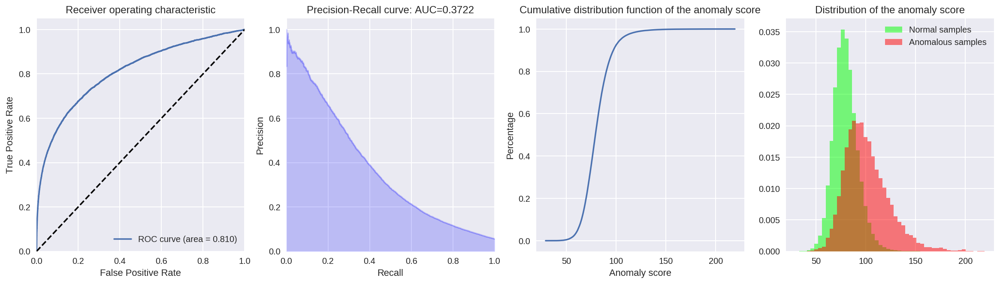

In [77]:
%matplotlib inline
score_ganomaly = os.path.join(inference_dir, "score_ganomaly.npy")
label_ganomaly = os.path.join(inference_dir, "label_ganomaly.npy")
scores_vis = np.load(score_ganomaly)
true_labels_ganomaly = np.load(label_ganomaly)
percentiles = np.asarray(config_ganomaly.trainer.percentiles);
per = np.percentile(scores_vis, percentiles);
for i,j in zip(per,percentiles):
    y_pred = scores_vis >= i;
    precision, recall, f1, _ = precision_recall_fscore_support(
        true_labels_ganomaly.astype(int), y_pred.astype(int), average="binary"
    )
    print(
        "Testing at with percentile value %f,percentile %f,  method %s: precision = %.4f, recall = %.4f, f1_score = %.4f"
        % (i,j, "fm",precision, recall, f1 )
    )
# ROC Curve
fpr, tpr, _ = roc_curve(true_labels_ganomaly, scores_vis)
roc_auc = auc(fpr, tpr)
# compute area under the curve

plt.figure(num=1,figsize=(20,5));
plt.subplot(1,4,1);
plt.plot(fpr, tpr, label="ROC curve (area = %0.3f)" % (roc_auc));
plt.plot([0, 1], [0, 1], "k--");
plt.xlim([0.0, 1.0]);
plt.ylim([0.0, 1.05]);
plt.xlabel("False Positive Rate");
plt.ylabel("True Positive Rate");
plt.title("Receiver operating characteristic");
plt.legend(loc="lower right");
# # PRC Curve

precision, recall, thresholds = precision_recall_curve(true_labels_ganomaly, scores_vis)
prc_auc = auc(recall, precision)

plt.subplot(1,4,2);
plt.step(recall, precision, color="b", alpha=0.2, where="post");
plt.fill_between(recall, precision, step="post", alpha=0.2, color="b");
plt.xlabel("Recall");
plt.ylabel("Precision");
plt.ylim([0.0, 1.05]);
plt.xlim([0.0, 1.0]);
plt.title("Precision-Recall curve: AUC=%0.4f" % (prc_auc));


# # Cumulative Distribution
N = len(scores_vis);
X2 = np.sort(scores_vis);
F2 = np.array(range(N)) / float(N);

plt.subplot(1,4,3);
plt.xlabel("Anomaly score");
plt.ylabel("Percentage");
plt.title("Cumulative distribution function of the anomaly score");
plt.plot(X2, F2);


# # Histogram
plt.subplot(1,4,4);
idx_inliers = true_labels_ganomaly == 0
idx_outliers = true_labels_ganomaly == 1
hrange = (min(scores_vis), max(scores_vis))
plt.hist(
    scores_vis[idx_inliers],
    50,
    facecolor=(0, 1, 0, 0.5),
    label="Normal samples",
    density=True,
    range=hrange,
);
plt.hist(
    scores_vis[idx_outliers],
    50,
    facecolor=(1, 0, 0, 0.5),
    label="Anomalous samples",
    density=True,
    range=hrange,
);
plt.title("Distribution of the anomaly score");
plt.legend();



# SkipGANomaly

In [ ]:
config_file = 'configs/skip_ganomaly.json'
exp_name = "skip_ganomaly_1"
config_skip_ganomaly = process_config(config_file,exp_name)

In [ ]:
# Create the dataloader
data = create("data_loader." + config.data_loader.name)(config)
# Create the summarizer Object
summarizer = create("utils." + config.log.name)(sess, config)
# Create the model instance
model = create("models." + config.model.name)(config)
# Create the trainer
trainer = create("trainers." + config.trainer.name)(sess, model, data, config, summarizer)
# Load model if exists
model.load(sess)